<a href="https://colab.research.google.com/github/z-arabi/SRU-deeplearning-workshop/blob/master/docs/11_Tensorboard_profiling_keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Copyright 2020 The TensorFlow Authors.

In [1]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# TensorFlow Profiler: Profile model performance

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tensorboard/tensorboard_profiling_keras"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/tensorboard/blob/master/docs/tensorboard_profiling_keras.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/tensorboard/blob/master/docs/tensorboard_profiling_keras.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View source on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/tensorboard/docs/tensorboard_profiling_keras.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
</table>

## Overview
Machine learning algorithms are typically computationally expensive. It is thus vital to quantify the performance of your machine learning application to ensure that you are running the most optimized version of your model. Use the TensorFlow Profiler to profile the execution of your TensorFlow code.


## Setup

In [2]:
from datetime import datetime
from packaging import version

import os

The TensorFlow Profiler requires the latest versions of TensorFlow and TensorBoard (`>=2.2`).


In [3]:
!pip install -U tensorboard_plugin_profile

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 66.1 MB/s eta 0:00:00


In [4]:
import tensorflow as tf

print("TensorFlow version: ", tf.__version__)

TensorFlow version:  2.12.0


Confirm that TensorFlow can access the GPU.

In [5]:
device_name = tf.test.gpu_device_name()
if not device_name:
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


## Train an image classification model with TensorBoard callbacks

In this tutorial, you explore the capabilities of the TensorFlow Profiler by capturing the performance profile obtained by training a model to classify images in the [MNIST dataset](http://yann.lecun.com/exdb/mnist/).

Use TensorFlow datasets to import the training data and split it into training and test sets.

In [6]:
import tensorflow_datasets as tfds
tfds.disable_progress_bar()

In [7]:
(ds_train, ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

Dataset mnist downloaded and prepared to /root/tensorflow_datasets/mnist/3.0.1. Subsequent calls will reuse this data.


In [8]:
print(type(ds_train))
ds_info

<class 'tensorflow.python.data.ops.prefetch_op._PrefetchDataset'>


tfds.core.DatasetInfo(
    name='mnist',
    full_name='mnist/3.0.1',
    description="""
    The MNIST database of handwritten digits.
    """,
    homepage='http://yann.lecun.com/exdb/mnist/',
    data_path='/root/tensorflow_datasets/mnist/3.0.1.incompleteP7CIC5',
    file_format=tfrecord,
    download_size=11.06 MiB,
    dataset_size=21.00 MiB,
    features=FeaturesDict({
        'image': Image(shape=(28, 28, 1), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=10),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'test': <SplitInfo num_examples=10000, num_shards=1>,
        'train': <SplitInfo num_examples=60000, num_shards=1>,
    },
    citation="""@article{lecun2010mnist,
      title={MNIST handwritten digit database},
      author={LeCun, Yann and Cortes, Corinna and Burges, CJ},
      journal={ATT Labs [Online]. Available: http://yann.lecun.com/exdb/mnist},
      volume={2},
      year={2010}
    }"""

Preprocess the training and test data by normalizing pixel values to be between 0 and 1.

<_TakeDataset element_spec=(TensorSpec(shape=(28, 28, 1), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>
4


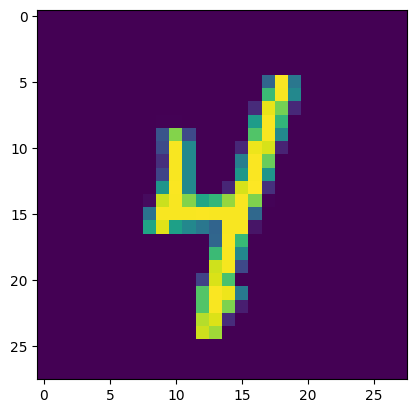

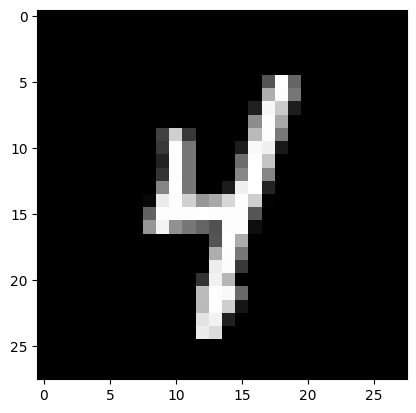

In [9]:
import matplotlib.pyplot as plt

single_item = ds_train.take(1)
print(single_item)
# 1*(image,label)
image, label = tuple(single_item.as_numpy_iterator())[0]
print(label)

plt.imshow(image)
plt.show()

plt.imshow(image,cmap="gray")
plt.show()

In [10]:
# how to convert tf data
def normalize_img(image, label):
  """Normalizes images: `uint8` -> `float32`."""
  # like astype == cast
  # return must be tuple
  return tf.cast(image, tf.float32) / 255., label

ds_train = ds_train.map(normalize_img)
ds_train = ds_train.batch(128)

In [11]:
ds_test = ds_test.map(normalize_img)
ds_test = ds_test.batch(128)

Create the image classification model using Keras.

In [12]:
'''
we have an image with size: 28*28*1
if we want to use dense in forst layer > we have to reshape to 784
then >
model = Sequential()
model.add(Dense(64, activation='relu', input_dim=784))

now >
the flatten does this for us > doesn't add any parameter
tf.keras.layers.Flatten(input_shape=(28, 28, 1))
'''

model = tf.keras.models.Sequential([
  tf.keras.layers.Flatten(input_shape=(28, 28, 1)),
  tf.keras.layers.Dense(128,activation='relu'),
  tf.keras.layers.Dense(10, activation='softmax')
])

# we didn't one hotted the labels
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.keras.optimizers.Adam(0.001),
    metrics=['accuracy']
)

Create a TensorBoard callback to capture performance profiles and call it while training the model.

In [13]:
# Create a TensorBoard callback
logs = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

'''
Profiling is a technique for analyzing the performance of a TensorFlow model by
measuring the time taken by each operation in the computation graph. This can help
identify performance bottlenecks and optimize the model for faster training and inference.

By default, profiling is disabled (profile_batch = 0), but if profile_batch is
set to an integer n, profiling will start after the nth batch and continue for
every batch thereafter. The profile_batch argument can also be a comma-separated
 string of two integers, specifying the starting and ending batch indices for profiling.
'''
tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs,
                                                 histogram_freq = 1,
                                                 profile_batch = '500,520')

model.fit(ds_train,
          epochs=2,
          validation_data=ds_test,
          callbacks = [tboard_callback])

Epoch 1/2
469/469 [==============================] - 24s 31ms/step - loss: 0.3542 - accuracy: 0.9024 - val_loss: 0.1891 - val_accuracy: 0.9462
Epoch 2/2
469/469 [==============================] - 6s 12ms/step - loss: 0.1650 - accuracy: 0.9527 - val_loss: 0.1368 - val_accuracy: 0.9595


## Use the TensorFlow Profiler to profile model training performance

The TensorFlow Profiler is embedded within TensorBoard. Load TensorBoard using Colab magic and launch it. View the performance profiles by navigating to the **Profile** tab.

In [14]:
# Load the TensorBoard notebook extension.
%load_ext tensorboard

The performance profile for this model is similar to the image below.

In [15]:
# Launch TensorBoard and navigate to the Profile tab to view performance profile
%tensorboard --logdir=logs

<IPython.core.display.Javascript object>

<!-- <img class="tfo-display-only-on-site" src="https://github.com/tensorflow/tensorboard/blob/master/docs/images/profiler_overview_page_bad_ip.png?raw=1"/> -->

The **Profile** tab opens the Overview page which shows you a high-level summary of your model performance. Looking at the Step-time Graph on the right, you can see that the model is highly input bound (i.e., it spends a lot of time in the data input piepline). The Overview page also gives you recommendations on potential next steps you can follow to optimize your model performance.

To understand where the performance bottleneck occurs in the input pipeline, select the **Trace Viewer** from the **Tools** dropdown on the left. The Trace Viewer shows you a timeline of the different events that occured on the CPU and the GPU during the profiling period.

The Trace Viewer shows multiple event groups on the vertical axis. Each event group has multiple horizontal tracks, filled with trace events. The track is an event timeline for events executed on a thread or a GPU stream. Individual events are the colored, rectangular blocks on the timeline tracks. Time moves from left to right. Navigate the trace events by using the keyboard shortcuts `W` (zoom in), `S` (zoom out), `A` (scroll left), and `D` (scroll right).

A single rectangle represents a trace event. Select the mouse cursor icon in the floating tool bar (or use the keyboard shortcut `1`) and click the trace event to analyze it. This will display information about the event, such as its start time and duration.

In addition to clicking, you can drag the mouse to select a group of trace events. This will give you a list of all the events in that area along with an event summary. Use the `M` key to measure the time duration of the selected events.

Trace events are collected from:

*   **CPU:** CPU events are displayed  under an event group named `/host:CPU`. Each track represents a thread on CPU. CPU events include input pipeline events, GPU operation (op) scheduling events, CPU op execution events etc.
*   **GPU:** GPU events are displayed under event groups prefixed by `/device:GPU:`. Each event group represents one stream on the GPU.

## Debug performance bottlenecks

Use the Trace Viewer to locate the performance bottlenecks in your input pipeline. The image below is a snapshot of the performance profile.

![profiler_trace_viewer_bad_ip](https://github.com/tensorflow/tensorboard/blob/master/docs/images/profiler_trace_viewer_bad_ip.png?raw=1)

Looking at the event traces, you can see that the GPU is inactive while the `tf_data_iterator_get_next` op is running on the CPU. This op is responsible for processing the input data and sending it to the GPU for training. As a general rule of thumb, it is a good idea to always keep the device (GPU/TPU) active.

Use the `tf.data` API to optimize the input pipeline. In this case, let's cache the training dataset and prefetch the data to ensure that there is always data available for the GPU to process. See [here](https://www.tensorflow.org/guide/data_performance) for more details on using `tf.data` to optimize your input pipelines.


In [22]:
# input_ouline > if it takes too much rsource > so the tf data is not correctly loading
# catch and prefetch can be helpful
(ds_train, ds_test), ds_info = tfds.load(
    'mnist',
    split=['train', 'test'],
    shuffle_files=True,
    as_supervised=True,
    with_info=True,
)

In [23]:
'''
ds_train = ds_train.cache(), instructs TensorFlow to cache (i.e., store in memory)
the elements of the training dataset ds_train after they have been loaded from disk.
This is done to avoid repeatedly loading the data from disk for each training epoch,
which can be a slow process. By caching the data in memory, subsequent epochs will be
able to access the data much more quickly.

ds_train = ds_train.prefetch(tf.data.experimental.AUTOTUNE), instructs TensorFlow to
prefetch the next batch of data while the current batch is being processed.
This is done to overlap the time it takes to load and preprocess data with the
time it takes to train the model. The tf.data.experimental.AUTOTUNE argument tells
TensorFlow to dynamically determine the optimal number of elements to prefetch based
on available system resources.
'''

ds_train = ds_train.map(normalize_img)
ds_train = ds_train.batch(128)
ds_train = ds_train.cache()
ds_train = ds_train.prefetch(tf.data.experimental.AUTOTUNE)

In [24]:
ds_test = ds_test.map(normalize_img)
ds_test = ds_test.batch(128)
ds_test = ds_test.cache()
ds_test = ds_test.prefetch(tf.data.experimental.AUTOTUNE)

Train the model again and capture the performance profile by reusing the callback from before.

In [25]:
model.fit(ds_train,
          epochs=2,
          validation_data=ds_test,
          callbacks = [tboard_callback])

Epoch 1/2
469/469 [==============================] - 7s 15ms/step - loss: 0.0731 - accuracy: 0.9797 - val_loss: 0.0901 - val_accuracy: 0.9723
Epoch 2/2
469/469 [==============================] - 2s 3ms/step - loss: 0.0603 - accuracy: 0.9835 - val_loss: 0.0847 - val_accuracy: 0.9745


Re-launch TensorBoard and open the **Profile** tab to observe the performance profile for the updated input pipeline.

The performance profile for the model with the optimized input pipeline is similar to the image below.

In [26]:
%tensorboard --logdir=logs

Reusing TensorBoard on port 6006 (pid 1291), started 0:05:53 ago. (Use '!kill 1291' to kill it.)

<IPython.core.display.Javascript object>

<!-- <img class="tfo-display-only-on-site" src="https://github.com/tensorflow/tensorboard/blob/master/docs/images/profiler_overview_page_good_ip.png?raw=1"/> -->

From the Overview page, you can see that the Average Step time has reduced as has the Input Step time. The Step-time Graph also indicates that the model is no longer highly input bound. Open the Trace Viewer to examine the trace events with the optimized input pipeline.

![profiler_trace_viewer_good_ip](https://github.com/tensorflow/tensorboard/blob/master/docs/images/profiler_trace_viewer_good_ip.png?raw=1)

The Trace Viewer shows that the `tf_data_iterator_get_next` op executes much faster. The GPU therefore gets a steady stream of data to perform training and achieves much better utilization through model training.

## Summary

Use the TensorFlow Profiler to profile and debug model training performance. Read the [Profiler guide](https://www.tensorflow.org/guide/profiler) and watch the [Performance profiling in TF 2](https://www.youtube.com/watch?v=pXHAQIhhMhI) talk from the TensorFlow Dev Summit 2020 to learn more about the TensorFlow Profiler.